In [10]:
%reset
%matplotlib inline

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import mne
from mne import create_info
import pickle
import os
from os.path import exists

import scipy.stats as stats
from scipy.stats import sem
from scipy.signal import find_peaks

In [12]:
## Import epochs
epochs_dir = 'C:\AnatArzData\YKM_data\epochs_and_evoked_allSubs'
import_type = "5Electorodes_plainEEGLAB"
trial_exclution_str = "_excOulierTrials-3.5" #"_excOulierTrials-2.5"

In [13]:
class AuxFuncs:
    def __init__(self, import_path):
        ## import epochs data and meta-data
        with open(import_path, 'rb') as file:
            [allEvents_df, allEpochs_perCond, cfg] = pickle.load(file)

        self.allEpochs_perCond = allEpochs_perCond
        self.allEvents_df = allEvents_df
        self.cfg = cfg
        self.info, self.montage = self.get_subject_info()

        self.max_freq = cfg['sample_freq'] / 2  # for tfr
        self.times = cfg['times']
        self.time0_i = np.where(self.times == 0)[0][0]
        self.hz_y = np.fft.rfftfreq(len(self.times[self.time0_i:]), 1.0 / cfg['sample_freq'])

    def get_subject_info(self, example_subject='32'):
        subject_setfile_wake_n = f'{self.cfg["set_files_dir"]}\s_{example_subject}_wake_night_referenced.set'
        output_file_path = f"{self.cfg['outputs_dir_path']}/epochs_Wn_s{example_subject}_file"

        if exists(output_file_path):
            with open(output_file_path, 'rb') as config_dictionary_file:
                epochs_Wn_example_sub = pickle.load(config_dictionary_file)
                #print(epochs_Wn_example_sub)
        else:
            epochs_Wn_example_sub = mne.io.read_epochs_eeglab(subject_setfile_wake_n, events=None, event_id=None,
                                                              eog=(), verbose=None, uint16_codec=None)
            with open(output_file_path, 'wb') as epochs_Wn_s_example_file:
                pickle.dump(epochs_Wn_example_sub, epochs_Wn_s_example_file)

        montage = mne.channels.make_standard_montage('GSN-HydroCel-128')
        epochs_Wn_example_sub_piked = epochs_Wn_example_sub.pick_channels(self.cfg['ch_names'])
        epochs_Wn_example_sub_monatged = epochs_Wn_example_sub_piked.set_montage(montage)
        epochs_info = epochs_Wn_example_sub_monatged.info
        return epochs_info, epochs_Wn_example_sub_monatged

    def getEpochsPerCond(self, cond_df, dataset):
        df_minTrials = cond_df[(cond_df.SamplesCount > 0)]  # discard cond with 0 enough samples
        keys = (str(key) for key in df_minTrials.Cond_id)
        epochs_allSamples = {str_key: dataset[str_key] for str_key in keys}
        return df_minTrials, epochs_allSamples

    # output: [#conds, #elect, #times]
    def getEvokedPerCondAndElectd(self, constraints, dataset, y_ax, outputType='array', tmin=-0.1, baseline=(None, 0)):
        curr_df = self.allEvents_df.copy()
        # apply constraints
        for key in constraints: curr_df = curr_df[(curr_df[key] == constraints[key])]

        conds_df, epochsPerCond = self.getEpochsPerCond(curr_df, dataset)
        evoked_perCond_andElectd = np.zeros((len(epochsPerCond), np.size(self.cfg['electrodes']), np.size(y_ax)))

        for cond_i, cond in enumerate(epochsPerCond):
            evoked_perCond_andElectd[cond_i] = np.squeeze(np.nanmean(epochsPerCond[cond], axis=2))

        if outputType == 'array':
            return conds_df, evoked_perCond_andElectd
        if outputType == 'mne':
            mne_epochs = mne.EpochsArray(evoked_perCond_andElectd, self.info, tmin=tmin, baseline=baseline)
            return conds_df, mne_epochs

    # output: [#epochs, #elect, #times]
    def getEpochsPerConstraint(self, constraints):
        curr_df =self.allEvents_df.copy(deep=True)
        # apply constraints
        for key in constraints: curr_df = curr_df[(curr_df[key] == constraints[key])]

        curr_df = curr_df[(curr_df.SamplesCount > 0)] # discard cond with 0 enough samples
        epochsPerCond = {}
        for key in curr_df.Cond_id:
            epochsPerCond[str(key)] = self.allEpochs_perCond[str(key)]

        ## load the metadata first and them the data. More time efficient
        epochs_name_in_const = []
        epochs_trial_num_per_cond = []
        for cond in epochsPerCond:
            for curr_cond_trial in range( epochsPerCond[cond].shape[2]):
                if len(epochs_name_in_const)==0:
                    epochs_name_in_const =[cond]
                    epochs_trial_num_per_cond =[curr_cond_trial]
                else:
                    epochs_name_in_const = np.append(epochs_name_in_const,cond)
                    epochs_trial_num_per_cond = np.append(epochs_trial_num_per_cond,curr_cond_trial)

        epochs_in_const = np.zeros((len(epochs_name_in_const),len(cfg['electrodes']),len(cfg['times'])))
        trial = 0
        for cond in epochsPerCond:
            for curr_cond_trial in range( epochsPerCond[cond].shape[2]):
                epochs_in_const[trial,:,:] = epochsPerCond[cond][:,:,curr_cond_trial]
                trial+=1

        return epochs_in_const, epochs_name_in_const, epochs_trial_num_per_cond

import_path = f'{epochs_dir}\\{import_type}{trial_exclution_str}.pkl'
aux = AuxFuncs(import_path)

allEpochs_perCond = aux.allEpochs_perCond
allEvents_df = aux.allEvents_df
cfg = aux.cfg
times = aux.times
time0_i = aux.time0_i

fig_output_dir = f"{cfg['outputs_dir_path']}\Prete22"
if not os.path.exists(fig_output_dir):
    os.mkdir(fig_output_dir)

In [14]:
def applyDesign(ax,title='',y_lims=[-4,4]):
    fig.patch.set_facecolor('xkcd:white')
    ax.set_facecolor('silver')
    ax.set_title(title,fontsize = 18, fontweight = 'bold')
    ax.legend(loc = 'upper right',prop={'size': 10})
    ax.axvline(x=0,color='gray', linestyle='--',label ="_nolegend_")
    ax.axhline(y=0, color='gray', linestyle='-',label ="_nolegend_")
    ax.set_ylabel(' uV', fontsize = 16, fontweight = 'bold')
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('Time (ms)', fontsize = 16, fontweight = 'bold')
    ax.set_xlim([-100,450])
    ax.set_ylim(y_lims)
    ax.text(-0.02, y_lims[1], 'stimulus', rotation=90, va='center', fontsize = 13)

colors_wngt = plt.cm.Blues([250,230,210,190,170,150,130,110,90])
colors_N2 = plt.cm.autumn_r([150,140,130,120,110,100,80,60,30])
colors_N3 = plt.cm.Greens([250,230,210,190,170,150,130,110,90])
colors_REM = plt.cm.Reds([250,230,210,190,170,150,130,110,90])
colors_allShadesPerVg = [colors_wngt,colors_N2,colors_N3,colors_REM]
colors_onePerVg = [colors_wngt[2],colors_N2[2],colors_N3[2],colors_REM[2]]
titles_onePerVg = ['Awake','N2','N3','REM']

Not setting metadata
76 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
95 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
1684 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
205 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
272 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
4650 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
5

C:\Users\Sharon\AppData\Local\Temp/ipykernel_19172/3865865471.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 4,sharex=True, sharey=False,figsize = (20,6))


Not setting metadata
75 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
99 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
1709 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
273 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
316 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
5989 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Not setting metadata
4

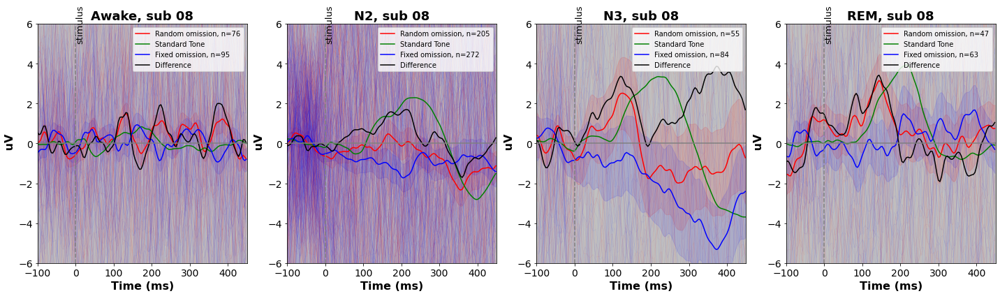

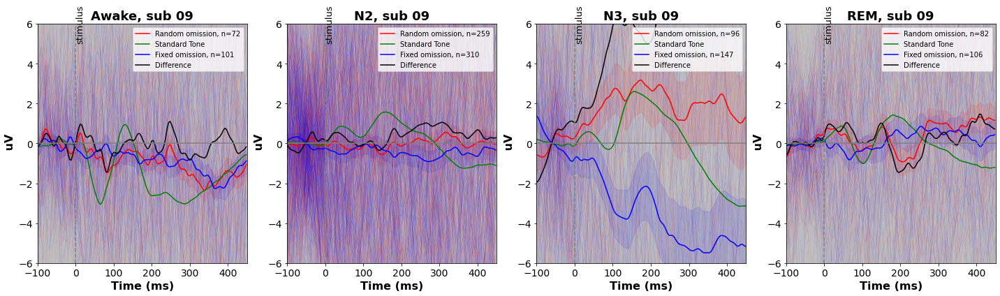

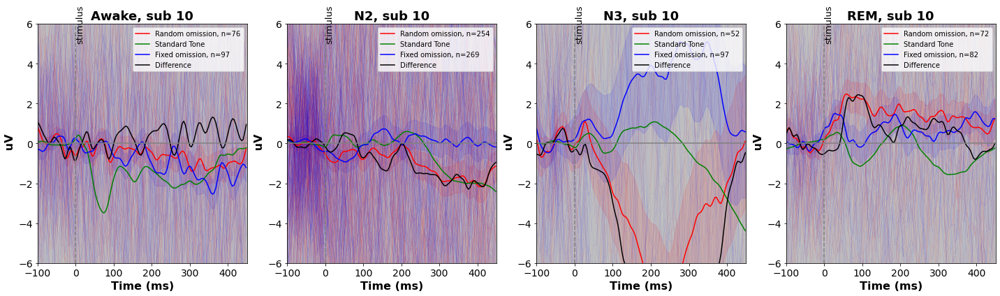

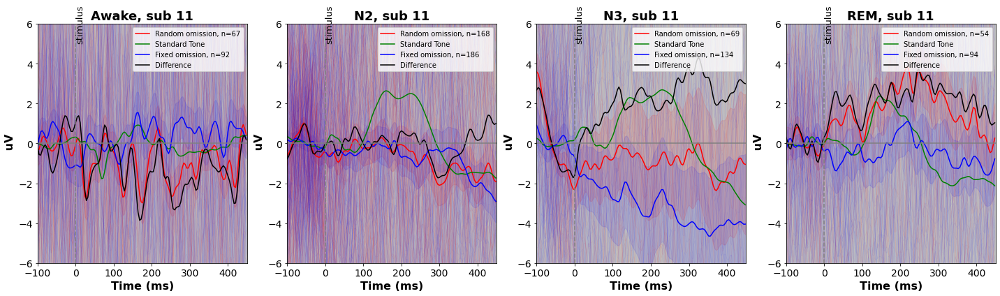

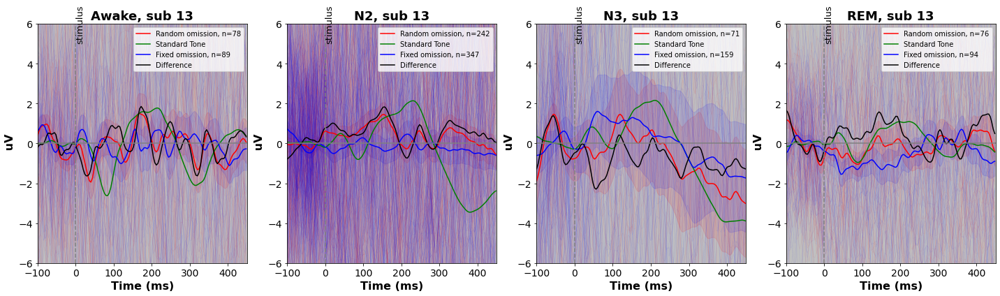

...

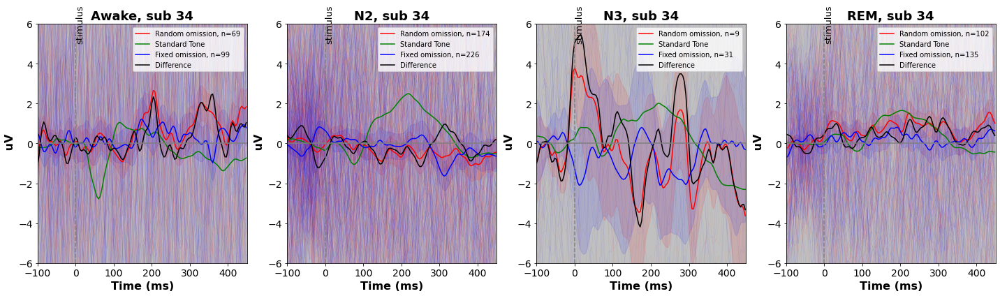

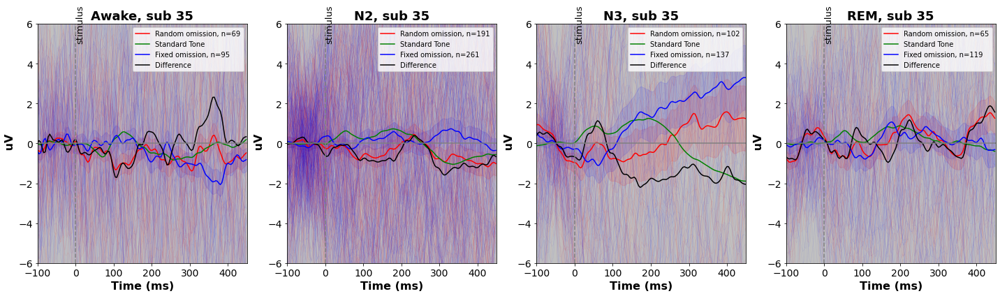

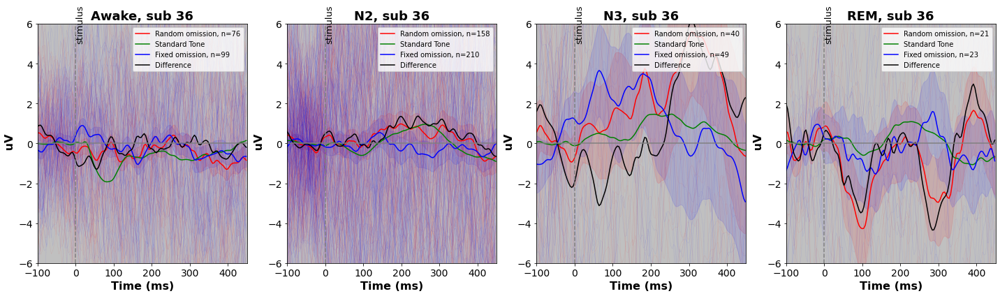

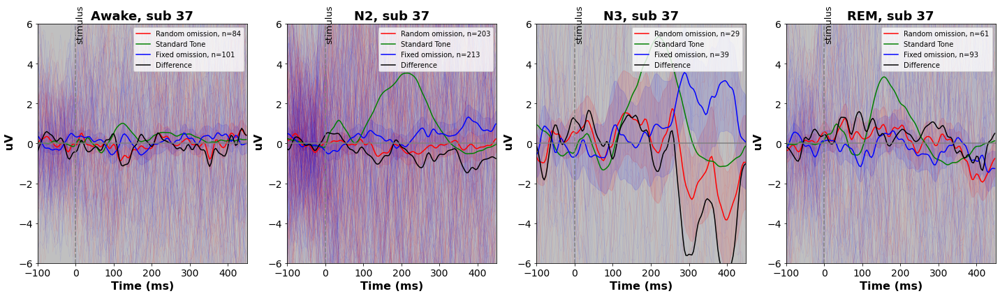

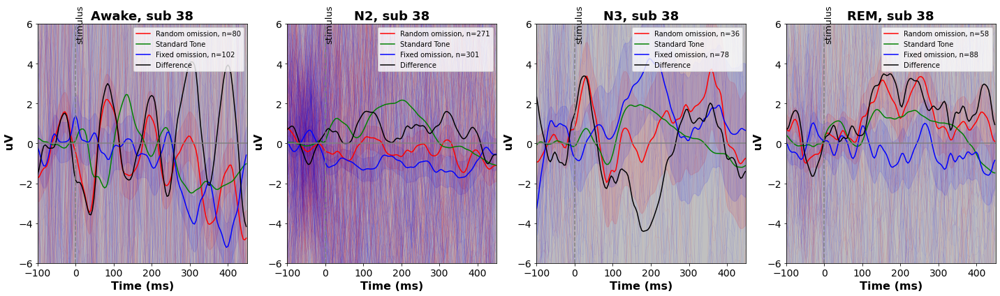

In [15]:
## Compute MMN amplitude per sub
mmn_amp_per_sub = np.zeros((len(cfg['subs']),len(cfg['vigi_states'])))
diff_per_SubVigi = np.zeros((len(cfg['subs']),len(cfg['vigi_states']),len(cfg['times'])))
mean_rand_per_SubVigi = np.zeros((len(cfg['subs']),len(cfg['vigi_states']),len(cfg['times'])))
mean_fixed_per_SubVigi = np.zeros((len(cfg['subs']),len(cfg['vigi_states']),len(cfg['times'])))

time100_i = np.where(times == 100)[0][0]
time300_i = np.where(times == 300)[0][0]

fig_output_subdir = f"{fig_output_dir}\PerSub"
if not os.path.exists(fig_output_subdir):
    os.mkdir(fig_output_subdir)

for subj_i, sub in enumerate(cfg['subs']):
    fig, axs = plt.subplots(1, 4,sharex=True, sharey=False,figsize = (20,6))
    for vigi_i, vigi in enumerate(cfg['vigi_states']):
        const_rand = {'Subject':sub, 'Vigilance': vigi, 'TOA_cond':'Rand'}
        const_fixed = {'Subject':sub, 'Vigilance': vigi, 'TOA_cond':'Fixed'}
        const_T = {'Subject':sub, 'Vigilance': vigi, 'TOA_cond':'T'}
        epochs_rand, __, __ = aux.getEpochsPerConstraint(const_rand)    # output: [#epochs, #elect, #times]
        epochs_fixed, __, __ = aux.getEpochsPerConstraint(const_fixed)  # output: [#epochs, #elect, #times]
        epochs_T, __, __ = aux.getEpochsPerConstraint(const_T)  # output: [#epochs, #elect, #times]
        mne_epochs_rand = mne.EpochsArray(epochs_rand, aux.info, tmin=-0.1, baseline=(None,0))
        mne_epochs_fixed = mne.EpochsArray(epochs_fixed, aux.info, tmin=-0.1, baseline=(None,0))
        mne_epochs_T = mne.EpochsArray(epochs_T, aux.info, tmin=-0.1, baseline=(None,0))
        epochs_rand = mne_epochs_rand.get_data()    # output: [#epochs, #elect, #times]
        epochs_fixed =mne_epochs_fixed.get_data()  # output: [#epochs, #elect, #times]
        epochs_T =mne_epochs_T.get_data()  # output: [#epochs, #elect, #times]

        # elecd_num = 1
        # mean_rand = np.mean(epochs_rand[:,elecd_num,:],axis = 0)
        # mean_fixed = np.mean(epochs_fixed[:,elecd_num,:],axis = 0)
        # std_rand = np.std(epochs_rand[:,elecd_num,:],axis = 0)
        # std_fixed = np.std(epochs_fixed[:,elecd_num,:],axis = 0)
        mean_rand = np.mean(epochs_rand,axis = (0,1))
        mean_fixed = np.mean(epochs_fixed,axis = (0,1))
        mean_T = np.mean(epochs_T,axis = (0,1))
        sem_rand = sem(np.mean(epochs_rand,axis = 1),axis = 0)
        sem_fixed = sem(np.mean(epochs_rand,axis = 1),axis = 0)
        diff = np.mean(np.mean(epochs_rand,axis = 0) - np.mean(epochs_fixed,axis = 0),axis = 0)

        ## save for all-subject graphs
        diff_per_SubVigi[subj_i,vigi_i,:] = diff
        mean_rand_per_SubVigi[subj_i,vigi_i,:] = mean_rand
        mean_fixed_per_SubVigi[subj_i,vigi_i,:] = mean_fixed

        ## plot per subject and vigi
        axs[vigi_i].plot(times,np.mean(epochs_rand,axis = 1).T,color='red',alpha=0.08, linewidth=0.5)
        axs[vigi_i].plot(times,np.mean(epochs_fixed,axis = 1).T,color='blue',alpha=0.08, linewidth=0.5)
        #axs[vigi_i].plot(times,np.mean(epochs_T,axis = 1).T,color='green',alpha=0.08, linewidth=0.5)
        axs[vigi_i].fill_between(times,mean_rand+sem_rand,mean_rand-sem_rand, color='red',alpha=0.1,label ="_nolegend_")
        label = f"Random omission, n={epochs_rand.shape[0]}"
        axs[vigi_i].plot(times,mean_rand,color='red',label=label)
        axs[vigi_i].plot(times,mean_T,color='green',label="Standard Tone")
        axs[vigi_i].fill_between(times,mean_fixed+sem_fixed,mean_fixed-sem_fixed, color='blue',alpha=0.1,label ="_nolegend_")
        label = f"Fixed omission, n={epochs_fixed.shape[0]}"
        axs[vigi_i].plot(times,mean_fixed,color='blue',label=label)
        axs[vigi_i].plot(times,diff,color='black',label='Difference')
        plot_title = f'{titles_onePerVg[vigi_i]}, sub {sub}'
        applyDesign(axs[vigi_i],plot_title,y_lims=[-6,6])

        #### Compute as in Prete22
        ## in the difference array: find local minima between 100 and 300 ms
        ## average amplitude in 50ms window around the peak (25 each side)
        diff_mmn_time = diff[time100_i:time300_i]
        peaks, _ = find_peaks(-diff_mmn_time)
        min_in_mmn_range = np.min(diff_mmn_time[peaks])
        min_i_in_mmn_range = np.where(diff_mmn_time == min_in_mmn_range)[0][0]

        range_for_mean_min = time100_i + min_i_in_mmn_range - 6 # -26ms
        range_for_mean_max = time100_i + min_i_in_mmn_range + 6 # +26ms

        mean_around_min = np.mean(diff[range_for_mean_min:range_for_mean_max])
        mmn_amp_per_sub[subj_i,vigi_i] = mean_around_min
    plt.tight_layout()
    plt.ioff()
    plt.savefig(f'{fig_output_subdir}/sub{sub}_5CentElectMean.png')
    #plt.show()

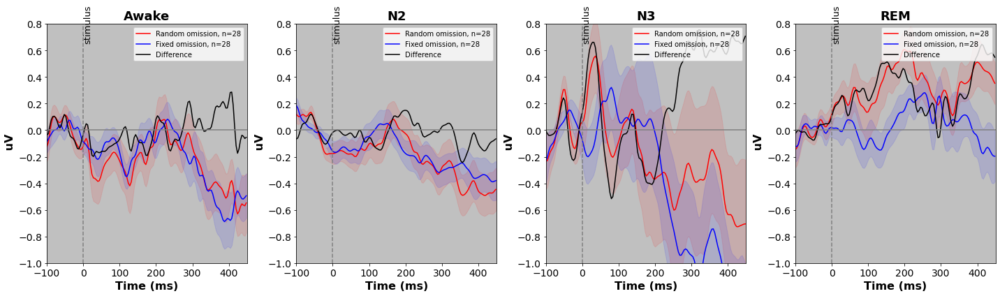

In [16]:
fig, axs = plt.subplots(1, 4,sharex=True, sharey=False,figsize = (20,6))
for vigi_i, vigi in enumerate(cfg['vigi_states']):
    diff = np.mean(diff_per_SubVigi[:,vigi_i,:],axis=0)
    mean_rand = np.mean(mean_rand_per_SubVigi[:,vigi_i,:],axis=0)
    sem_rand = sem(mean_rand_per_SubVigi[:,vigi_i,:],axis=0)
    mean_fixed = np.mean(mean_fixed_per_SubVigi[:,vigi_i,:],axis=0)
    sem_fixed = sem(mean_fixed_per_SubVigi[:,vigi_i,:],axis=0)

    axs[vigi_i].fill_between(times,mean_rand+sem_rand,mean_rand-sem_rand, color='red',alpha=0.1,label ="_nolegend_")
    label = f"Random omission, n={len(cfg['subs'])}"
    axs[vigi_i].plot(times,mean_rand,color='red',label=label)
    axs[vigi_i].fill_between(times,mean_fixed+sem_fixed,mean_fixed-sem_fixed, color='blue',alpha=0.1,label ="_nolegend_")
    label = f"Fixed omission, n={len(cfg['subs'])}"
    axs[vigi_i].plot(times,mean_fixed,color='blue',label=label)
    axs[vigi_i].plot(times,diff,color='black',label='Difference')
    plot_title = f'{titles_onePerVg[vigi_i]}'
    applyDesign(axs[vigi_i],plot_title,y_lims=[-1,0.8])
plt.tight_layout()
#plt.ioff()
plt.savefig(f'{fig_output_dir}/allSubs_5CentElectMean.png')
plt.show()

In [17]:
### compute t-tests
for vigi_i, vigi in enumerate(cfg['vigi_states']):
    t_statistic, p_value = stats.ttest_1samp(a=mmn_amp_per_sub[:,vigi_i], popmean=0,alternative='less')
    print(f'Vigilance: {vigi}, t_statistic = {t_statistic}, p_value = {float("{:.8f}".format(float(p_value)))}')

Vigilance: Wn, t_statistic = -4.124984031587464, p_value = 0.00015886
Vigilance: N2, t_statistic = -4.436743970067301, p_value = 6.912e-05
Vigilance: N3, t_statistic = -1.411660946992659, p_value = 0.08473548
Vigilance: REM, t_statistic = -2.100225436085215, p_value = 0.02259365


In [18]:
mmn_amp_per_sub

array([[ -0.69016124,   0.16024003,   0.46042627,  -0.2967444 ],
       [ -0.24495531,  -0.12657826,   5.31035758,  -1.05267408],
       [  0.15184994,  -1.56846591, -11.94773785,   0.4447707 ],
       [ -2.27402817,   0.03281243,   1.95044778,   2.44427349],
       [ -0.19104947,  -0.30333779,  -1.28552529,  -0.48573246],
       [ -0.51292521,   1.21507362,  -3.49124448,  -1.17415727],
       [ -0.65787456,  -0.30537454,  -3.19067329,  -0.43177233],
       [ -0.63660798,  -0.58857162,   0.90757235,  -0.65747122],
       [ -0.02327357,  -0.9330285 ,  -3.03243676,  -0.5757579 ],
       [ -1.70952214,  -0.52980733,   4.83777904,   0.26284049],
       [  0.85831854,  -0.50698889,  -0.21818005,  -1.2548786 ],
       [  0.48249991,  -0.79593229,   1.81909603,  -0.39611473],
       [ -0.30005385,  -0.10518828,  -8.93681132,  -1.07260476],
       [ -0.63710203,  -2.05806007,  -0.65174713,  -0.22102975],
       [ -0.2807968 ,  -0.73475051,   0.66728347,  -1.14482289],
       [ -0.38259086,  -0